## Configuration

In [1]:
import sys
import os

SEED = 42
VAL_PCT = 0.2
DEBUG = True

GRADIENT = os.path.exists('train')
KAGGLE = os.path.exists('../input')

if KAGGLE:
    !mkdir -p uwmadisonutils
    !cp ../input/uw-madison-models/*.py uwmadisonutils/
    !cp -r ../input/pytorch-segmentation-models-lib/ ./
    !pip install -q ./pytorch-segmentation-models-lib/pretrainedmodels-0.7.4/pretrainedmodels-0.7.4
    !pip install -q ./pytorch-segmentation-models-lib/efficientnet_pytorch-0.6.3/efficientnet_pytorch-0.6.3
    !pip install -q ./pytorch-segmentation-models-lib/timm-0.4.12-py3-none-any.whl
    !pip install -q ./pytorch-segmentation-models-lib/segmentation_models_pytorch-0.2.0-py3-none-any.whl


if KAGGLE:
    sys.path.insert(0, '../input/uwmadisonutils/')
    data_path = '../input/uw-madison-gi-tract-image-segmentation/'
    
elif GRADIENT:
    sys.path.insert(0, 'uwmadisonutils/')
    data_path = ''

from uwmadisonutils.utilities import *

## Libraries and Data

In [2]:
path = Path(data_path+'train')
test_path = Path(data_path+'test')

train = pd.read_csv(data_path+'train.csv', low_memory=False)
sample_submission = pd.read_csv(data_path+'sample_submission.csv', low_memory=False).rename(columns={'predicted': 'segmentation'})

train_path = Path(data_path+'train')
test_path = Path(data_path+'test')

train_fnames = get_image_files(train_path)
test_fnames = get_image_files(test_path)

## Prepare Data

In [3]:
if sample_submission.shape[0] > 0: 
    test = sample_submission.copy()
else:
    test_fnames = train_fnames
    test_path = train_path
    test = train.copy()
    test = test.sample(frac=1.0, random_state=SEED)

test = get_custom_df(test, test_fnames, str(test_path), channels=3, stride=2)
train = get_custom_df(train, train_fnames, str(train_path), channels=3, stride=2)

## Pipeline preparation and test

In [4]:
models = ['uwmadisonutils/exp-31-f0-e99.pkl']
ws = [1]

In [5]:
def unpad_img(img, org_size):
    shape0 = np.array(org_size)
    resize = np.array(img.shape[:2])
    if np.any(shape0!=resize):
        diff = resize - shape0
        pad0 = diff[0]
        pad1 = diff[1]
        pady = [pad0//2, pad0//2 + pad0%2]
        padx = [pad1//2, pad1//2 + pad1%2]
        
        if pady[0] != 0:
            img = img[pady[0]:-pady[1], :, :]
            
        if padx[0] != 0:
            img = img[:, padx[0]:-padx[1], :]
            
        img = img.reshape((*shape0, img.shape[-1]))
    return img

def pad_img(img, up_size=None):
    if up_size is None:
        return img
    shape0 = np.array(img.shape[:2])
    resize = np.array(up_size)
    if np.any(shape0!=resize):
        diff = resize - shape0
        pad0 = diff[0]
        pad1 = diff[1]
        pady = [pad0//2, pad0//2 + pad0%2]
        padx = [pad1//2, pad1//2 + pad1%2]
        padz = [0, 0]
        img = np.pad(img, [pady, padx, padz])
        img = img.reshape((*resize, img.shape[-1]))
    return img

def resize_img_to_org_size(img, org_size):
    shape0 = np.array(img.shape[:2])
    diff = org_size - shape0
    if np.any(diff < 0):
        img = pad_img(img, (320, 384))
        resized = unpad_img(img, org_size)
    else:
        resized = pad_img(img, org_size)
    return resized

def mask2rle(mask):
    """
    img: numpy array, 1 - mask, 0 - background
    Returns run length as string formated
    """
    mask = np.array(mask)
    pixels = mask.flatten()
    pad = np.array([0])
    pixels = np.concatenate([pad, pixels, pad])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]

    return " ".join(str(x) for x in runs)

def get_rle_masks(preds, df):
    rle_masks = []
    for pred, width, height in zip(preds, df['slice_w'], df['slice_h']):
        upsized_mask = resize_img_to_org_size(pred, (height, width))
        for i in range(3):
            rle_mask = mask2rle(upsized_mask[:, :, i])
            rle_masks.append(rle_mask)
    return rle_masks

def get_case_id(fname):
    if KAGGLE: i = 5
    elif GRADIENT: i = 2
    return fname.parts[i] + '_' + fname.parts[i+2][:10]

In [6]:
def get_tta_preds(learn, b, deep_supervision):
    b_preds1 = learn.model(b)
    b_preds2 = learn.model(b.flip_lr())
    # b_preds3 = learn.model(b.flipud())
    # b_preds4 = learn.model(b.flip_lr().flipud())

    if deep_supervision: 
        b_preds1 = b_preds1[-1]
        b_preds2 = b_preds2[-1]
        # b_preds3 = b_preds3[-1]
        # b_preds4 = b_preds4[-1]

    b_preds = (sigmoid(b_preds1) +
               sigmoid(b_preds2.flip_lr())
               # sigmoid(b_preds3.flipud()) + 
               # sigmoid(b_preds4.flip_lr().flipud())
              ) / 2
    
    return b_preds


def get_mask_predictions(df, dl, models, ws, thresh=0.5):
    
    learns = [load_learner(model, cpu=False) for model in models]
    
    for learn in learns:
        learn.model.eval()
        learn.model = learn.model.cuda()
        
    deep_supervision = [hasattr(learn.model, 'deep_supervision') for learn in learns]
    
    masks = []
    
    bs = dl.bs

    with torch.no_grad():
        for i, b in enumerate(tqdm(dl)):
            inp = b
            
            b_preds = None
            
            for j, learn in enumerate(learns):
                
                if torch.is_tensor(b_preds):
                    b_preds += ws[j]*get_tta_preds(learn, inp, deep_supervision[j])
                else:
                    b_preds = ws[j]*get_tta_preds(learn, inp, deep_supervision[j])
                    
            b_preds = b_preds / len(learns)
                        
            b_preds = (b_preds > thresh).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)
            
            b_preds = post_process(b_preds)
                
            masks.extend(get_rle_masks(b_preds, df.iloc[i*bs:i*bs+bs]))
            
                        
            del inp
            del b_preds

            torch.cuda.empty_cache()
            gc.collect()
            
    submission = pd.DataFrame({
        'id': chain.from_iterable([[get_case_id(fname)]*3 for fname in df['fname']]),
        'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in df['fname']]),
        'slice_h': chain.from_iterable([[df['slice_h'].iloc[i]]*3 for i in range(len(df))]),
        'slice_w': chain.from_iterable([[df['slice_w'].iloc[i]]*3 for i in range(len(df))]),
        'flag': chain.from_iterable([df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(df))]),
        'segmentation': chain.from_iterable([df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(df))]),
        'predicted': masks,
    })
        
    return submission

In [7]:
dls, dev = get_5C_25D_dls(train, aug='albu', tfms_kwargs=dict(train=get_train_aug, test=get_test_aug), 
                          channels=3, fold=0, bs=32, val_crop=1.0, resize=1.0, sample_empty=False, show=False)

/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)


In [8]:
dev.columns

Index(['id', 'fname', 'fnames', 'n_segs', 'lb_seg_rle', 'lb_seg_flag',
       'sb_seg_rle', 'sb_seg_flag', 'st_seg_rle', 'st_seg_flag', 'slice_h',
       'slice_w', 'px_spacing_h', 'px_spacing_w', 'case_id_str', 'case_id',
       'day_num_str', 'day_num', 'case_id_day_num_str', 'slice_id',
       'is_valid'],
      dtype='object')

In [38]:
# Test pipeline by predicting for only one day
val_df = dev.query('is_valid')

random_day = np.random.choice(val_df.case_id_day_num_str.unique(), size=1)[0]

df = val_df[val_df.case_id_day_num_str == random_day]

dl = dls.test_dl(df)

In [113]:
sub = get_mask_predictions(df, dl, models, ws, thresh=0.485)

100%|██████████| 5/5 [00:17<00:00,  3.53s/it]


In [7]:
def get_pred_mask(sub, case_id, up_size=None):
    case_id_df = sub[sub.id == case_id]
        
    slice_h, slice_w = case_id_df.slice_h.iloc[0], case_id_df.slice_w.iloc[0]
    
    if up_size:
        mask = np.zeros((*up_size, 3))
    else:
        mask = np.zeros((slice_h, slice_w, 3))
        
    lb_seg = case_id_df.loc[case_id_df['class'] == "large_bowel", "predicted"].item()
    sb_seg = case_id_df.loc[case_id_df['class'] == "small_bowel", "predicted"].item()
    st_seg = case_id_df.loc[case_id_df['class'] == "stomach", "predicted"].item()
    
    for i, seg in enumerate([lb_seg, sb_seg, st_seg]):
        if seg != "":
            mask[..., i] += pad_img(rle_decode(seg, shape=(slice_h, slice_w), color=255), up_size)
        
    return mask
    

In [8]:
def compare_truth_preds(df, sub, case_day):
        
    case_day_df = df[df.case_id_day_num_str == case_day].sort_values('id').reset_index(drop=True)
    
    slices_len = len(case_day_df)
    
    fig, axes = plt.subplots(slices_len, 2, figsize=(10, slices_len*5))
        
    for i, row in case_day_df.iterrows():
        
        img = get_25D_image(row)
        targ_mask = get_mask(row)/255
        pred_mask = get_pred_mask(sub, row['id'])/255
        
        show_image(img, ctx=axes[i, 0], title=row['id']+'_true')
        show_image(targ_mask, ctx=axes[i, 0], alpha=0.4, title=row['id']+'_true')
        
        show_image(img, ctx=axes[i, 1], title=row['id']+'_pred')
        show_image(pred_mask, ctx=axes[i, 1], alpha=0.4, title=row['id']+'_pred')

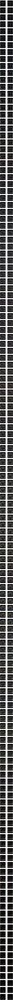

In [132]:
compare_truth_preds(df, sub, random_day)

### Find the worst scoring cases

In [9]:
def dice_coeff_row(row):
    dice = 0.0
    
    if row['flag']:
        
        inp = rle_decode(row['predicted'], (row['slice_h'], row['slice_w']))
        targ = rle_decode(row['segmentation'], (row['slice_h'], row['slice_w']))

        eps = 1e-5
        I = (targ * inp).sum()
        U = targ.sum() + inp.sum()
        dice = (2*I)/(U+eps)
        
    return dice

In [179]:
val_df = dev.query('is_valid')

case_days = val_df.case_id_day_num_str.unique()

sample_case_days = np.random.choice(case_days, len(case_days)//10)

val_df = val_df[val_df.case_id_day_num_str.isin(sample_case_days)]

val_dl = dls.test_dl(val_df)

sub = get_mask_predictions(val_df, val_dl, models, ws, thresh=0.485)

100%|██████████| 23/23 [01:26<00:00,  3.76s/it]


In [180]:
sub['dice'] = sub.apply(dice_coeff_row, axis=1)

In [181]:
sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

0.7331415657838954

In [168]:
sub['case_day'] = sub['id'].str.split('_').apply(lambda x: x[0]) + '_' + sub['id'].str.split('_').apply(lambda x: x[1])

In [169]:
case_day_mean_dice = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('case_day')['dice'].mean()
case_day_mean_dice

case_day
case134_day22    0.595466
case2_day3       0.720443
case36_day0      0.846441
case43_day26     0.522837
case67_day12     0.754218
Name: dice, dtype: float64

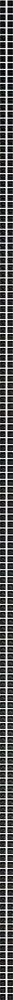

In [170]:
compare_truth_preds(val_df, sub, 'case43_day26')

In [182]:
sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()

class
large_bowel    0.796410
small_bowel    0.624152
stomach        0.796479
Name: dice, dtype: float64

### Test larger threshold effect on mean class dice

In [183]:
sub = get_mask_predictions(val_df, val_dl, models, ws, thresh=0.515)

100%|██████████| 23/23 [01:26<00:00,  3.77s/it]


In [184]:
sub['dice'] = sub.apply(dice_coeff_row, axis=1)

In [185]:
sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()

class
large_bowel    0.794357
small_bowel    0.620492
stomach        0.811517
Name: dice, dtype: float64

In [187]:
sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

0.733295371975419

In [192]:
for thresh in np.linspace(0.3, 0.7, 10):
    print('Threshold', thresh)
    sub = get_mask_predictions(val_df, val_dl, models, ws, thresh)
    sub['dice'] = sub.apply(dice_coeff_row, axis=1)
    
    print('Dice per class', 
          sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean())
    
    print('Mean dice score', 
          sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean())
    
    print()

Threshold 0.3


100%|██████████| 23/23 [01:28<00:00,  3.84s/it]


Dice per class class
large_bowel    0.789426
small_bowel    0.622052
stomach        0.762343
Name: dice, dtype: float64
Mean dice score 0.7235192741310458

Threshold 0.34444444444444444


100%|██████████| 23/23 [01:28<00:00,  3.83s/it]


Dice per class class
large_bowel    0.789384
small_bowel    0.620985
stomach        0.763108
Name: dice, dtype: float64
Mean dice score 0.7233324197882566

Threshold 0.38888888888888884


100%|██████████| 23/23 [01:28<00:00,  3.84s/it]


Dice per class class
large_bowel    0.795063
small_bowel    0.619603
stomach        0.769670
Name: dice, dtype: float64
Mean dice score 0.7274004761117913

Threshold 0.4333333333333333


100%|██████████| 23/23 [01:28<00:00,  3.83s/it]


Dice per class class
large_bowel    0.794779
small_bowel    0.621203
stomach        0.770455
Name: dice, dtype: float64
Mean dice score 0.7272889730265149

Threshold 0.47777777777777775


100%|██████████| 23/23 [01:28<00:00,  3.83s/it]


Dice per class class
large_bowel    0.796727
small_bowel    0.621882
stomach        0.795920
Name: dice, dtype: float64
Mean dice score 0.7332084402806813

Threshold 0.5222222222222221


100%|██████████| 23/23 [01:27<00:00,  3.81s/it]


Dice per class class
large_bowel    0.794104
small_bowel    0.620766
stomach        0.811882
Name: dice, dtype: float64
Mean dice score 0.7326163407999784

Threshold 0.5666666666666667


100%|██████████| 23/23 [01:27<00:00,  3.82s/it]


Dice per class class
large_bowel    0.795993
small_bowel    0.616078
stomach        0.817385
Name: dice, dtype: float64
Mean dice score 0.7333005397317268

Threshold 0.611111111111111


100%|██████████| 23/23 [01:27<00:00,  3.81s/it]


Dice per class class
large_bowel    0.800580
small_bowel    0.610883
stomach        0.816488
Name: dice, dtype: float64
Mean dice score 0.7352741422659336

Threshold 0.6555555555555554


100%|██████████| 23/23 [01:27<00:00,  3.81s/it]


Dice per class class
large_bowel    0.798991
small_bowel    0.606741
stomach        0.814309
Name: dice, dtype: float64
Mean dice score 0.732887328106005

Threshold 0.7


100%|██████████| 23/23 [01:27<00:00,  3.81s/it]


Dice per class class
large_bowel    0.802772
small_bowel    0.605845
stomach        0.813514
Name: dice, dtype: float64
Mean dice score 0.7344033145664308



### Test various thresholds using exp-35 with model for each fold

In [10]:
def build25d(pat):
    md = torch.load(pat)
    md.to('cuda')
    md.eval()
    return md

from fastai.vision.all import sigmoid as fastsigmoid

def get_tta_preds(learn, b, deep_supervision):
    b_preds1 = learn(b)
    
    b_preds2 = learn(torch.flip(b, dims=[3]))    
    
    if deep_supervision: 
        b_preds1 = b_preds1[-1]
        b_preds2 = b_preds2[-1]

    b_preds = (fastsigmoid(b_preds1) +
               fastsigmoid(torch.flip(b_preds2, dims=[3]))                 
              ) / 2
    
    return b_preds


def get_mask_predictions(df, dl, models, ws, thresh=0.5):
    
    learns = [build25d(model) for model in models]
        
    deep_supervision = [True for learn in learns]
    
    masks = []
    
    bs = dl.bs

    with torch.no_grad():
        for i, b in enumerate(tqdm(dl)):
            inp = b
            
            b_preds = None
            
            for j, learn in enumerate(learns):
                
                if torch.is_tensor(b_preds):
                    b_preds += ws[j]*get_tta_preds(learn, inp, deep_supervision[j])
                else:
                    b_preds = ws[j]*get_tta_preds(learn, inp, deep_supervision[j])
                    
            b_preds = b_preds / len(learns)
                        
            b_preds = (b_preds > thresh).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)
            
            b_preds = post_process(b_preds)
                
            masks.extend(get_rle_masks(b_preds, df.iloc[i*bs:i*bs+bs]))
            
                        
            del inp
            del b_preds

            torch.cuda.empty_cache()
            gc.collect()
            
    submission = pd.DataFrame({
        'id': chain.from_iterable([[get_case_id(fname)]*3 for fname in df['fname']]),
        'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in df['fname']]),
        'slice_h': chain.from_iterable([[df['slice_h'].iloc[i]]*3 for i in range(len(df))]),
        'slice_w': chain.from_iterable([[df['slice_w'].iloc[i]]*3 for i in range(len(df))]),
        'flag': chain.from_iterable([df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(df))]),
        'segmentation': chain.from_iterable([df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(df))]),
        'predicted': masks,
    })
        
    return submission

In [11]:
def get_mask_logits(df, dl, models, ws):
    
    learns = [build25d(model) for model in models]
        
    deep_supervision = [True for learn in learns]
    
    masks = []
    
    bs = dl.bs
    
    preds = []

    with torch.no_grad():
        for i, b in enumerate(tqdm(dl)):
            inp = b
            
            b_preds = None
            
            for j, learn in enumerate(learns):
                
                if torch.is_tensor(b_preds):
                    b_preds += ws[j]*get_tta_preds(learn, inp, deep_supervision[j])
                else:
                    b_preds = ws[j]*get_tta_preds(learn, inp, deep_supervision[j])
                    
            b_preds = b_preds / len(learns)
            
            preds.append(b_preds)
                        
    return torch.cat(preds, dim=0)

In [12]:
import glob

models = sorted(glob.glob('exp-35/*.pt'))
ws = [1, 1, 1, 1, 1]

In [18]:
threshs = np.linspace(0.2, 0.7, 11)
threshs

array([0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 , 0.65, 0.7 ])

In [16]:
folds = range(5)
sample_pct = 0.1

oof_logits = []
oof_ens_logits = []
oof_df = []

for fold in folds:
    # Create dls 
    dls, dev = get_5C_25D_dls(train, aug='albu', tfms_kwargs=dict(train=get_train_aug, test=get_test_aug), 
                      channels=3, fold=fold, bs=32, val_crop=1.0, resize=1.0, sample_empty=False, show=False)

    # Create validation dls and sample 10% of it
    val_df = dev.query('is_valid')
    
    # Sample random slices
    val_df = val_df.sample(frac=sample_pct)
    val_dl = dls.test_dl(val_df)
    oof_df.append(val_df)

    # Get predictions for single model
    fold_logits = get_mask_logits(val_df, val_dl, models[fold:fold+1], [1])
    oof_logits.append(fold_logits)
    
oof_logits = torch.cat(oof_logits, dim=0)
oof_df = pd.concat(oof_df)

/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████| 25/25 [01:20<00:00,  3.21s/it]
/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████|

In [17]:
torch.save(oof_logits, 'oof_logits.pt')
oof_df.to_csv('oof_df.csv', index=False)

### Testing thresholds

In [13]:
folds = range(5)
sample_pct = 0.1

lb_scores = []
sb_scores = []
st_scores = []
dice_scores = []
model_names = []
thresh_names = []
fold_names = []

for thresh in threshs:
    for fold in folds:
        # Create dls 
        dls, dev = get_5C_25D_dls(train, aug='albu', tfms_kwargs=dict(train=get_train_aug, test=get_test_aug), 
                          channels=3, fold=fold, bs=32, val_crop=1.0, resize=1.0, sample_empty=False, show=False)
        
        # Create validation dls and sample 10% of it
        val_df = dev.query('is_valid')
        
        # np.random.seed(42)
        
        ## Sample using case days
        # case_days = val_df.case_id_day_num_str.unique()
        # sample_case_days = np.random.choice(case_days, int(len(case_days)*sample_pct))
        # val_df = val_df[val_df.case_id_day_num_str.isin(sample_case_days)]
        
        # Sample random slices
        
        val_df = val_df.sample(frac=sample_pct)
        val_dl = dls.test_dl(val_df)
        
        # Get predictions for single model
        sub = get_mask_predictions(val_df, val_dl, models[fold:fold+1], [1], thresh)
        sub['dice'] = sub.apply(dice_coeff_row, axis=1)
        
        # Add results
        mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
        mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()
        
        lb_scores.append(mean_class_scores['large_bowel'])
        sb_scores.append(mean_class_scores['small_bowel'])
        st_scores.append(mean_class_scores['stomach'])
        dice_scores.append(mean_dice_score)
        thresh_names.append(thresh)
        model_names.append(models[fold].rstrip('.pt').lstrip('exp-35/'))
        fold_names.append(fold)
        
#         # Get predictions for ensemble
#         sub = get_mask_predictions(val_df, val_dl, models, [1, 1, 1, 1, 1], thresh)
#         sub['dice'] = sub.apply(dice_coeff_row, axis=1)
        
#         # Add results
#         mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
#         mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()
        
#         lb_scores.append(mean_class_scores['large_bowel'])
#         sb_scores.append(mean_class_scores['small_bowel'])
#         st_scores.append(mean_class_scores['stomach'])
#         dice_scores.append(mean_dice_score)
#         thresh_names.append(thresh)
#         model_names.append('exp-35-ensemble')
#         fold_names.append(fold)

        scores_df = pd.DataFrame({'thresh': thresh_names, 'fold': fold_names, 'model': model_names,
                            'lb_score': lb_scores, 'sb_score': sb_scores, 
                            'st_score': st_scores, 'dice': dice_scores})
        scores_df.to_csv('scores_df.csv', index=False)

/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████| 25/25 [01:27<00:00,  3.50s/it]
/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████|

In [18]:
scores_df.groupby('thresh')[['lb_score', 'sb_score', 'st_score', 'dice']].mean()

,lb_score,sb_score,st_score,dice
thresh,,,,
0.20,0.765573,0.660591,0.793978,0.736043
0.25,0.767157,0.660547,0.797533,0.737280
0.30,0.768398,0.661153,0.800788,0.738203
0.35,0.767729,0.663331,0.804731,0.739049
0.40,0.768339,0.663699,0.805896,0.739586
0.45,0.769777,0.665187,0.807087,0.740167
0.50,0.770421,0.665210,0.809839,0.741130
0.55,0.769149,0.664576,0.811692,0.740096
0.60,0.769946,0.662577,0.811460,0.740301


### Single model thresholds

In [27]:
folds = range(5)
sample_pct = 0.1

oof_logits = []
oof_ens_logits = []
oof_df = []

for fold in folds:
    # Create dls 
    dls, dev = get_5C_25D_dls(train, aug='albu', tfms_kwargs=dict(train=get_train_aug, test=get_test_aug), 
                      channels=3, fold=fold, bs=32, val_crop=1.0, resize=1.0, sample_empty=False, show=False)

    # Create validation dls and sample 10% of it
    val_df = dev.query('is_valid')
    
    # Sample random slices
    val_df = val_df.sample(frac=sample_pct)
    val_dl = dls.test_dl(val_df)
    oof_df.append(val_df)

    # Get predictions for single model
    fold_logits = get_mask_logits(val_df, val_dl, models[fold:fold+1], [1])
    oof_logits.append(fold_logits)
    
    # # Get predictions for ensemble
    # fold_ens_logits = get_mask_logits(val_df, val_dl, models, ws)
    # oof_ens_logits.append(fold_ens_logits)

/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████| 25/25 [01:15<00:00,  3.01s/it]
/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████|

In [31]:
oof_logits = torch.cat(oof_logits, dim=0)

oof_df = pd.concat(oof_df)

In [35]:
lb_scores = []
sb_scores = []
st_scores = []
dice_scores = []
thresh_names = []
fold_names = []
scores_df = []

for thresh in tqdm(threshs):
    
    oof_preds = (oof_logits > thresh).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)

    masks = get_rle_masks(oof_preds, oof_df)

    sub = pd.DataFrame({
        'id': chain.from_iterable([[get_case_id(fname)]*3 for fname in oof_df['fname']]),
        'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
        'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
        'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
        'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
        'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
        'predicted': masks,
    })
    
    sub['dice'] = sub.apply(dice_coeff_row, axis=1)
    
    mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
    mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

    lb_scores.append(mean_class_scores['large_bowel'])
    sb_scores.append(mean_class_scores['small_bowel'])
    st_scores.append(mean_class_scores['stomach'])
    dice_scores.append(mean_dice_score)
    thresh_names.append(thresh)
    fold_names.append(fold)
    
    scores_df.append(pd.DataFrame({'thresh': thresh_names, 'fold': fold_names,
                                   'lb_score': lb_scores, 'sb_score': sb_scores, 
                                   'st_score': st_scores, 'dice': dice_scores}))
    

100%|██████████| 11/11 [02:38<00:00, 14.42s/it]


In [36]:
scores_df = pd.concat(scores_df)

In [37]:
scores_df.groupby('thresh')[['lb_score', 'sb_score', 'st_score', 'dice']].mean()

,lb_score,sb_score,st_score,dice
thresh,,,,
0.20,0.765906,0.659402,0.794521,0.736745
0.25,0.767432,0.659457,0.798169,0.738249
0.30,0.768829,0.660051,0.801140,0.739181
0.35,0.768177,0.662155,0.805514,0.740226
0.40,0.768918,0.662600,0.806767,0.741051
0.45,0.770376,0.664065,0.808008,0.741847
0.50,0.770936,0.664149,0.810905,0.742753
0.55,0.769596,0.663417,0.812784,0.741760
0.60,0.770358,0.661551,0.812524,0.742098


In [40]:
threshs = torch.tensor([0.5, 0.5, 0.7])[..., None, None].cuda()

oof_preds = (oof_logits > threshs).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)

masks = get_rle_masks(oof_preds, oof_df)

sub = pd.DataFrame({
    'id': chain.from_iterable([[get_case_id(fname)]*3 for fname in oof_df['fname']]),
    'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
    'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
    'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
    'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'predicted': masks,
})

sub['dice'] = sub.apply(dice_coeff_row, axis=1)

mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

print(mean_class_scores, mean_dice_score)

class
large_bowel    0.770936
small_bowel    0.664149
stomach        0.814085
Name: dice, dtype: float64 0.7430144116005745


### Ensemble thresholds

In [ ]:
folds = range(5)
sample_pct = 0.1

oof_logits = []
oof_ens_logits = []
oof_df = []

for fold in folds:
    # Create dls 
    dls, dev = get_5C_25D_dls(train, aug='albu', tfms_kwargs=dict(train=get_train_aug, test=get_test_aug), 
                      channels=3, fold=fold, bs=32, val_crop=1.0, resize=1.0, sample_empty=False, show=False)

    # Create validation dls and sample 10% of it
    val_df = dev.query('is_valid')
    
    # Sample using case days
    case_days = val_df.case_id_day_num_str.unique()
    sample_case_days = np.random.choice(case_days, int(len(case_days)*sample_pct))
    val_df = val_df[val_df.case_id_day_num_str.isin(sample_case_days)]
    val_dl = dls.test_dl(val_df)
    oof_df.append(val_df)

    # # Sample random slices
    # val_df = val_df.sample(frac=sample_pct)
    # val_dl = dls.test_dl(val_df)

    # # Get predictions for single model
    # fold_logits = get_mask_logits(val_df, val_dl, models[fold:fold+1], [1])
    # oof_logits.append(fold_logits)
    
    # Get predictions for ensemble
    fold_logits = get_mask_logits(val_df, val_dl, models, ws)
    oof_logits.append(fold_logits)

/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████| 23/23 [05:46<00:00, 15.05s/it]
/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████|

In [ ]:
oof_logits = torch.cat(oof_logits, dim=0)

In [ ]:
oof_df = pd.concat(oof_df)

In [ ]:
lb_scores = []
sb_scores = []
st_scores = []
dice_scores = []
thresh_names = []
fold_names = []
scores_df = []

for thresh in tqdm(threshs):
    
    oof_preds = (oof_logits > thresh).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)

    masks = get_rle_masks(oof_preds, oof_df)

    sub = pd.DataFrame({
        'id': chain.from_iterable([[get_case_id(fname)]*3 for fname in oof_df['fname']]),
        'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
        'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
        'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
        'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
        'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
        'predicted': masks,
    })
    
    sub['dice'] = sub.apply(dice_coeff_row, axis=1)
    
    mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
    mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

    lb_scores.append(mean_class_scores['large_bowel'])
    sb_scores.append(mean_class_scores['small_bowel'])
    st_scores.append(mean_class_scores['stomach'])
    dice_scores.append(mean_dice_score)
    thresh_names.append(thresh)
    fold_names.append(fold)
    
    scores_df.append(pd.DataFrame({'thresh': thresh_names, 'fold': fold_names,
                                   'lb_score': lb_scores, 'sb_score': sb_scores, 
                                   'st_score': st_scores, 'dice': dice_scores}))
    

In [ ]:
scores_df = pd.concat(scores_df)

In [ ]:
scores_df.groupby('thresh')[['lb_score', 'sb_score', 'st_score', 'dice']].mean()

In [31]:
threshs = torch.tensor([0.4, 0.4, 0.5])[..., None, None].cuda()

oof_preds = (oof_logits > threshs).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)

masks = get_rle_masks(oof_preds, oof_df)

sub = pd.DataFrame({
    'id': chain.from_iterable([[get_case_id(fname)]*3 for fname in oof_df['fname']]),
    'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
    'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
    'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
    'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'predicted': masks,
})

sub['dice'] = sub.apply(dice_coeff_row, axis=1)

mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

print(mean_class_scores, mean_dice_score)

class
large_bowel    0.874881
small_bowel    0.820404
stomach        0.872711
Name: dice, dtype: float64 0.8526704763070555


### Tunining post processing 

In [19]:
folds = range(5)
sample_pct = 0.1

oof_logits = []
oof_ens_logits = []
oof_df = []

for fold in folds:
    # Create dls 
    dls, dev = get_5C_25D_dls(train, aug='albu', tfms_kwargs=dict(train=get_train_aug, test=get_test_aug), 
                      channels=3, fold=fold, bs=32, val_crop=1.0, resize=1.0, sample_empty=False, show=False)

    # Create validation dls and sample 10% of it
    val_df = dev.query('is_valid')
    
    # Sample random slices
    val_df = val_df.sample(frac=sample_pct)
    val_dl = dls.test_dl(val_df)
    oof_df.append(val_df)

    # Get predictions for single model
    fold_logits = get_mask_logits(val_df, val_dl, models[fold:fold+1], [1])
    oof_logits.append(fold_logits)
    
oof_logits = torch.cat(oof_logits, dim=0)
oof_df = pd.concat(oof_df)

/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████| 25/25 [01:18<00:00,  3.15s/it]
/opt/conda/lib/python3.8/site-packages/torch/_tensor.py:1131: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  ret = func(*args, **kwargs)
100%|██████████|

In [61]:
def post_process(inp, contour):
    if inp.shape[-1] != 3: 
        sum_dims = (2, 3)
        inp[np.where(inp.sum(sum_dims) < contour)] = 0 

    else:
        sum_dims = (1, 2)
        idxs = np.where(inp.sum((1, 2)) < contour)
        inp[idxs[0], :, :, idxs[1]] = 0 

    return inp

In [70]:
threshs = np.linspace(0.4, 0.6, 5)
contours = np.arange(0, 210, 20)
print(threshs, contours)

[0.4  0.45 0.5  0.55 0.6 ] [  0  20  40  60  80 100 120 140 160 180 200]


In [71]:
oof_logits = torch.load('oof_logits.pt').cpu()
oof_df = pd.read_csv('oof_df.csv')

In [72]:
lb_scores = []
sb_scores = []
st_scores = []
dice_scores = []
thresh_names = []
contour_areas = []
scores_df = []

for thresh in threshs:
    print('Thresh', thresh)
    for contour in tqdm(contours):
    
        oof_preds = (oof_logits > thresh).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)
        
        oof_preds = post_process(oof_preds, contour)

        masks = get_rle_masks(oof_preds, oof_df)

        sub = pd.DataFrame({
            'id': chain.from_iterable([[get_case_id(Path(fname))]*3 for fname in oof_df['fname']]),
            'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
            'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
            'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
            'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
            'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
            'predicted': masks,
        })

        sub['dice'] = sub.apply(dice_coeff_row, axis=1)

        mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
        mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

        lb_scores.append(mean_class_scores['large_bowel'])
        sb_scores.append(mean_class_scores['small_bowel'])
        st_scores.append(mean_class_scores['stomach'])
        dice_scores.append(mean_dice_score)
        thresh_names.append(thresh)
        contour_areas.append(contour)

        scores_df.append(pd.DataFrame({'thresh': thresh_names, 'contour_areas': contour_areas, 
                                       'lb_score': lb_scores, 'sb_score': sb_scores, 
                                       'st_score': st_scores, 'dice': dice_scores}))

Thresh 0.4


100%|██████████| 11/11 [02:15<00:00, 12.30s/it]


Thresh 0.45


100%|██████████| 11/11 [02:16<00:00, 12.37s/it]


Thresh 0.5


100%|██████████| 11/11 [02:14<00:00, 12.21s/it]


Thresh 0.55


100%|██████████| 11/11 [02:14<00:00, 12.22s/it]


Thresh 0.6


100%|██████████| 11/11 [02:13<00:00, 12.15s/it]


In [73]:
single_scores_df = pd.concat(scores_df)
single_scores_df.to_csv('single_scores_df.csv', index=False)

In [74]:
single_scores_df.groupby(['thresh', 'contour_areas'])[['lb_score', 'sb_score', 'st_score', 'dice']].mean().loc[0.5, :]

,lb_score,sb_score,st_score,dice
contour_areas,,,,
0,0.770936,0.664149,0.810905,0.742753
20,0.771572,0.667613,0.815025,0.744651
40,0.772072,0.667352,0.816341,0.744837
60,0.772982,0.668470,0.815897,0.745684
80,0.773521,0.667407,0.816947,0.746010
100,0.772617,0.664367,0.815929,0.744697
120,0.769299,0.661002,0.821309,0.742837
140,0.768325,0.656808,0.818902,0.740894
160,0.766236,0.654378,0.817065,0.739524


In [79]:
single_scores_df.groupby(['thresh', 'contour_areas'])[['lb_score', 'sb_score', 'st_score', 'dice']].mean().sort_values('st_score', ascending=False).head(1)

,,lb_score,sb_score,st_score,dice
thresh,contour_areas,,,,
0.5,120,0.769299,0.661002,0.821309,0.742837


In [105]:
thresh = [0.55, 0.5, 0.5] 
contour = [80, 60, 120]

oof_preds = (oof_logits > torch.tensor(thresh)[..., None, None]).permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)
        
oof_preds = post_process(oof_preds, contour)

masks = get_rle_masks(oof_preds, oof_df)

sub = pd.DataFrame({
    'id': chain.from_iterable([[get_case_id(Path(fname))]*3 for fname in oof_df['fname']]),
    'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
    'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
    'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
    'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'predicted': masks,
})

sub['dice'] = sub.apply(dice_coeff_row, axis=1)

mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

print('Mean dice score by class', mean_class_scores)
print('Mean dice score', mean_dice_score)

Mean dice score by class class
large_bowel    0.773443
small_bowel    0.667170
stomach        0.820727
Name: dice, dtype: float64
Mean dice score 0.7462450193397171


### Triplet Threshold Tuning

In [13]:
def triplet_thresholding(inp, min_thresh, max_thresh, contour):
    max_mask = inp > max_thresh
    if inp.shape[-1] != 3: 
        sum_dims = (2, 3)
        idxs = np.where(max_mask.sum(sum_dims) < torch.tensor(contour)[None, ...])
        inp[idxs[0], idxs[1], ...] = 0 

    else:
        sum_dims = (1, 2)
        idxs = np.where(max_mask.sum(sum_dims) < contour)
        inp[idxs[0], :, :, idxs[1]] = 0 
        
    del max_mask
    del idxs
    gc.collect()
    
    return inp > min_thresh

In [95]:
oof_logits = torch.load('oof_logits.pt').cpu()
oof_df = pd.read_csv('oof_df.csv')

In [16]:
threshs = np.linspace(0.3, 0.7, 5)
contours = np.arange(50, 220, 20)
print(threshs, contours)

[0.3 0.4 0.5 0.6 0.7] [ 50  70  90 110 130 150 170 190 210]


In [17]:
lb_scores = []
sb_scores = []
st_scores = []
dice_scores = []
min_threshs = []
max_threshs = []
fold_names = []
contour_areas = []
scores_df = []

for min_thresh in threshs:
    for max_thresh in threshs:
        print('Threshs', max_thresh, min_thresh)
        for contour in tqdm(contours):
            oof_preds = triplet_thresholding(oof_logits, min_thresh, max_thresh, np.array([contour]*3))
    
            oof_preds = oof_preds.permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)

            masks = get_rle_masks(oof_preds, oof_df)

            sub = pd.DataFrame({
                'id': chain.from_iterable([[get_case_id(Path(fname))]*3 for fname in oof_df['fname']]),
                'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
                'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
                'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
                'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
                'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
                'predicted': masks,
            })

            sub['dice'] = sub.apply(dice_coeff_row, axis=1)

            mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
            mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()

            lb_scores.append(mean_class_scores['large_bowel'])
            sb_scores.append(mean_class_scores['small_bowel'])
            st_scores.append(mean_class_scores['stomach'])
            dice_scores.append(mean_dice_score)
            min_threshs.append(min_thresh)
            max_threshs.append(max_thresh)
            contour_areas.append(contour)

            scores_df.append(pd.DataFrame({'min_thresh': min_threshs, 'max_thresh': max_threshs,
                                           'contour_area': contour_areas, 'lb_score': lb_scores, 
                                           'sb_score': sb_scores,'st_score': st_scores, 'dice': dice_scores}))

Threshs 0.3 0.3


100%|██████████| 9/9 [02:11<00:00, 14.62s/it]


Threshs 0.39999999999999997 0.3


100%|██████████| 9/9 [02:09<00:00, 14.38s/it]


Threshs 0.5 0.3


100%|██████████| 9/9 [02:09<00:00, 14.41s/it]


Threshs 0.6 0.3


100%|██████████| 9/9 [02:09<00:00, 14.34s/it]


Threshs 0.7 0.3


100%|██████████| 9/9 [02:10<00:00, 14.45s/it]


Threshs 0.3 0.39999999999999997


100%|██████████| 9/9 [02:10<00:00, 14.53s/it]


Threshs 0.39999999999999997 0.39999999999999997


100%|██████████| 9/9 [02:09<00:00, 14.34s/it]


Threshs 0.5 0.39999999999999997


100%|██████████| 9/9 [02:09<00:00, 14.37s/it]


Threshs 0.6 0.39999999999999997


100%|██████████| 9/9 [02:08<00:00, 14.33s/it]


Threshs 0.7 0.39999999999999997


100%|██████████| 9/9 [02:09<00:00, 14.40s/it]


Threshs 0.3 0.5


100%|██████████| 9/9 [02:11<00:00, 14.58s/it]


Threshs 0.39999999999999997 0.5


100%|██████████| 9/9 [02:09<00:00, 14.44s/it]


Threshs 0.5 0.5


100%|██████████| 9/9 [02:09<00:00, 14.43s/it]


Threshs 0.6 0.5


100%|██████████| 9/9 [02:09<00:00, 14.37s/it]


Threshs 0.7 0.5


100%|██████████| 9/9 [02:09<00:00, 14.40s/it]


Threshs 0.3 0.6


100%|██████████| 9/9 [02:10<00:00, 14.49s/it]


Threshs 0.39999999999999997 0.6


100%|██████████| 9/9 [02:09<00:00, 14.42s/it]


Threshs 0.5 0.6


100%|██████████| 9/9 [02:10<00:00, 14.52s/it]


Threshs 0.6 0.6


100%|██████████| 9/9 [02:10<00:00, 14.46s/it]


Threshs 0.7 0.6


100%|██████████| 9/9 [02:10<00:00, 14.48s/it]


Threshs 0.3 0.7


100%|██████████| 9/9 [02:09<00:00, 14.38s/it]


Threshs 0.39999999999999997 0.7


100%|██████████| 9/9 [02:08<00:00, 14.30s/it]


Threshs 0.5 0.7


100%|██████████| 9/9 [02:08<00:00, 14.29s/it]


Threshs 0.6 0.7


100%|██████████| 9/9 [02:10<00:00, 14.49s/it]


Threshs 0.7 0.7


100%|██████████| 9/9 [02:10<00:00, 14.52s/it]


In [18]:
triplet_scores_df = pd.concat(scores_df)
triplet_scores_df.to_csv('triplet_scores_df.csv', index=False)

In [82]:
triplet_scores_df = pd.read_csv('triplet_scores_df.csv')

In [100]:
triplet_scores_df.groupby(['max_thresh', 'min_thresh', 'contour_area'])[['lb_score', 'sb_score', 'st_score', 'dice']].mean().sort_values('st_score', ascending=False)

lb_score  sb_score  st_score      dice
max_thresh min_thresh contour_area                                        
0.3        0.3        170           0.767107  0.661738  0.816300  0.741822
                      50            0.772834  0.672465  0.815745  0.747056
                      90            0.772311  0.671233  0.815086  0.746166
                      70            0.773326  0.672465  0.814921  0.746657
                      150           0.768442  0.662411  0.814746  0.741665
...                                      ...       ...       ...       ...
0.7        0.3        90            0.759563  0.648733  0.807392  0.735913
                      130           0.758977  0.647564  0.807392  0.735244
                      110           0.758977  0.648733  0.807392  0.735657
                      150           0.758469  0.647564  0.807392  0.734803
                      210           0.755623  0.642150  0.806415  0.732239

[225 rows x 4 columns]

In [101]:
min_thresh = 0.3
max_thresh = 0.3
contour = np.array([70, 50, 170])

oof_preds = triplet_thresholding(oof_logits, min_thresh, max_thresh, contour)
    
oof_preds = oof_preds.permute(0, 2, 3, 1).cpu().detach().numpy().astype(np.uint8)

masks = get_rle_masks(oof_preds, oof_df)

sub = pd.DataFrame({
    'id': chain.from_iterable([[get_case_id(Path(fname))]*3 for fname in oof_df['fname']]),
    'class': chain.from_iterable([['large_bowel', 'small_bowel', 'stomach'] for _ in oof_df['fname']]),
    'slice_h': chain.from_iterable([[oof_df['slice_h'].iloc[i]]*3 for i in range(len(oof_df))]),
    'slice_w': chain.from_iterable([[oof_df['slice_w'].iloc[i]]*3 for i in range(len(oof_df))]),
    'flag': chain.from_iterable([oof_df[['lb_seg_flag', 'sb_seg_flag', 'st_seg_flag']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'segmentation': chain.from_iterable([oof_df[['lb_seg_rle', 'sb_seg_rle', 'st_seg_rle']].iloc[i].values.tolist() for i in range(len(oof_df))]),
    'predicted': masks,
})

sub['dice'] = sub.apply(dice_coeff_row, axis=1)

mean_class_scores =  sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('class')['dice'].mean()
mean_dice_score = sub[~((sub['flag'] == False) & (sub['predicted'] == ''))].groupby('id')['dice'].mean().mean()
                   
print('Mean dice score by class', mean_class_scores)
print('Mean dice score', mean_dice_score)

Mean dice score by class class
large_bowel    0.773233
small_bowel    0.667137
stomach        0.812659
Name: dice, dtype: float64
Mean dice score 0.7441353614815204


### Extra

In [93]:
sub

,id,class,slice_h,slice_w,flag,segmentation,predicted,dice
0,case85_day29_slice_0013,large_bowel,310,360,False,NaN,,0.0
1,case85_day29_slice_0013,small_bowel,310,360,False,NaN,,0.0
2,case85_day29_slice_0013,stomach,310,360,False,NaN,,0.0
3,case139_day18_slice_0041,large_bowel,266,266,False,NaN,,0.0
4,case139_day18_slice_0041,small_bowel,266,266,False,NaN,,0.0
...,...,...,...,...,...,...,...,...
12241,case113_day22_slice_0015,small_bowel,310,360,False,NaN,,0.0
12242,case113_day22_slice_0015,stomach,310,360,False,NaN,,0.0
12243,case134_day22_slice_0040,large_bowel,310,360,False,NaN,,0.0
12244,case134_day22_slice_0040,small_bowel,310,360,False,NaN,,0.0
